# YOLOv8 Inference Notebook

In this notebook, we look at how good the different fine tuned YOLOv8 models perform quantitatively and qualitatively.

## TODO
- [ ] Check in the generated dataset that we don't have blank lines in yolov8 Pytorch txt format
- [ ] Check that empty lines are not a problem when training YOLOv8 in annotation files

## Imports

In [1]:
import os
from functools import reduce
from pathlib import Path
from collections import Counter
import seaborn as sns
import multiprocessing as mp
import pickle
import hashlib

import cv2
from tqdm.notebook import trange, tqdm
import matplotlib.pyplot as plt
import numpy as np
import PIL
import ultralytics
import yaml
from PIL import Image
from ultralytics import YOLO

## Global Variables

In [2]:
# Pick the train run number to load
MODEL_TRAIN_RUN_NUMBER = 14

CV_TASK = "segment"
MODEL_ROOT_DIR = Path(
    f"/home/chouffe/fruitpunch/challenges/coralreefs2/models/yolov8/train_runs/{CV_TASK}/train{MODEL_TRAIN_RUN_NUMBER}/"
)
MODEL_WEIGHTS_FILEPATH = MODEL_ROOT_DIR / "weights" / "best.pt"

# TODO: get this path from the model config
TRAIN_DATA_ROOT = Path(
    "/home/chouffe/fruitpunch/challenges/coralreefs2/datasets/benthic_datasets/yolov8_ready/SEAFLOWER_BOLIVAR_and_SEAFLOWER_COURTOWN_and_SEAVIEW_ATL_and_SEAVIEW_IDN_PHL_and_SEAVIEW_PAC_AUS_and_TETES_PROVIDENCIA"
)
# TRAIN_DATA_ROOT = Path(
#     "/home/chouffe/fruitpunch/challenges/coralreefs2/datasets/benthic_datasets/yolov8_ready/SEAFLOWER_BOLIVAR_and_SEAFLOWER_COURTOWN_and_SEAVIEW_ATL_and_SEAVIEW_IDN_PHL_and_SEAVIEW_PAC_AUS_and_TETES_PROVIDENCIA_2"
# )

FRUITPUNCH_CHALLENGE_PROJECT_ROOT = Path('/home/chouffe/fruitpunch/challenges/coralreefs2/')
CACHE_PATH = FRUITPUNCH_CHALLENGE_PROJECT_ROOT / '.cache'

CLASS_TO_COLOR_MAPPING = {
    1: (255, 0, 0),
    0: (0, 0, 255),
}

# TODO: get this from data.yaml
LABEL_TO_CLASS_MAPPING = {"soft_coral": 1, "hard_coral": 0, "other": 2}
CLASS_TO_LABEL_MAPPING = {v: k for k, v in LABEL_TO_CLASS_MAPPING.items()}


Polygon = np.ndarray
AnnotationEntry = dict
Annotation = list[AnnotationEntry]
Prediction = list[dict]

## Utilities and helpers

In [62]:
def yaml_content(path: Path) -> dict:
    """Returns yaml content as a python dict."""
    with open(path, "r") as f:
        return yaml.safe_load(f)


def image_filename_to_image_filepath(filename: str, split: str = "val") -> Path:
    return TRAIN_DATA_ROOT / split / "images" / filename


def label_filename_to_label_filepath(filename: str, split: str = "val") -> Path:
    return TRAIN_DATA_ROOT / split / "labels" / filename


def slurp(filepath: Path) -> str:
    with open(filepath, "r") as f:
        return f.read()


def load_image_filepath(image_filepath: Path) -> np.ndarray:
    return cv2.imread(str(image_filepath), cv2.IMREAD_COLOR)


def get_ground_truth_as_image(image_filename: str, split: str = "val") -> PIL.Image:
    image_filepath = image_filename_to_image_filepath(image_filename, split=split)
    orig_img = load_image_filepath(image_filepath)
    stem = image_filename.split(".")[0]
    label_filename = f"{stem}.txt"
    label_filepath = label_filename_to_label_filepath(label_filename, split=split)
    img = orig_img
    return img


def get_prediction_as_image(prediction) -> PIL.Image:
    im_array = prediction.plot(labels=False)
    im = Image.fromarray(im_array[..., ::-1])  # RGB PIL image
    return im


def denormalize_polygon(polygon: Polygon, W: int, H: int) -> Polygon:
    """`polygon`: numpy array of shape (_,2) containing the polygon x,y
    coordinates.

    `W`: int - width of the image / mask
    `H`: int - height of the image / mask

    returns a numpy array of shape `polygon.shape` with coordinates that are
    denormalized and between 0 and W or H.
    """
    copy = np.copy(polygon)
    copy = copy.astype(np.float16)
    copy[:, 0] *= W
    copy[:, 1] *= H
    copy = copy.astype(np.int32)

    return copy


def partition(lst, size):
    for i in range(0, len(lst), size):
        yield lst[i : i + size]


def draw_polygon(img: np.ndarray, polygon: Polygon, color) -> np.ndarray:
    return cv2.fillPoly(img, pts=[polygon], color=color)


def draw_bounding_box(img: np.ndarray, bbox, color, thickness: int = 3) -> np.ndarray:
    start_point, end_point = bbox
    return cv2.rectangle(img, start_point, end_point, color, thickness)


def bounding_box(points) -> tuple[tuple[float, float], tuple[float, float]]:
    x_coordinates, y_coordinates = zip(*points)
    return (
        (min(x_coordinates), min(y_coordinates)),
        (max(x_coordinates), max(y_coordinates)),
    )


def parse_annotation_line(
    annotation_line: str, orig_img: np.ndarray
) -> AnnotationEntry:
    W, H, _ = orig_img.shape
    elements = annotation_line.split(" ")
    object_class = int(elements[0])
    polygon_normalized = np.array(list(partition([float(e) for e in elements[1:]], 2)))
    polygon = denormalize_polygon(polygon_normalized, W=W, H=H)
    return {
        "class": object_class,
        "polygon_normalized": polygon_normalized,
        "polygon": polygon,
    }


def parse_annotation_raw(annotation_raw: str, orig_img: np.ndarray) -> Annotation:
    if annotation_raw == "":
        return []
    else:
        try:
            annotation_lines = annotation_raw.split("\n")
            result = [parse_annotation_line(line, orig_img) for line in annotation_lines if line.strip()]
            return result
        except:
            print(f'Parsing error with annotation_raw: {annotation_raw}')
            print(f'Returning empty annotation')
            return []


def generate_annotation_as_nd_array(
    annotation: Annotation,
    orig_img: np.ndarray,
    class_to_color_mapping: dict = CLASS_TO_COLOR_MAPPING,
    annotation_overlay_segment_alpha: float = 0.45,
    thickness: int = 2,
) -> np.ndarray:
    img = orig_img.copy()
    overlay_segment = orig_img.copy()
    for annotation_entry in annotation:
        color = class_to_color_mapping.get(annotation_entry["class"])
        overlay_segment = draw_polygon(
            overlay_segment, annotation_entry["polygon"], color
        )
        bbox = bounding_box(annotation_entry["polygon"])
        img = draw_bounding_box(img, bbox, color, thickness=thickness)
    img = cv2.addWeighted(
        overlay_segment,
        annotation_overlay_segment_alpha,
        img,
        1 - annotation_overlay_segment_alpha,
        0,
        img,
    )
    return img


def generate_annotation_raw_as_nd_array(
    annotation_raw: str,
    orig_img: np.ndarray,
    class_to_color_mapping: dict = CLASS_TO_COLOR_MAPPING,
) -> np.ndarray:
    annotation = parse_annotation_raw(annotation_raw, orig_img)
    return generate_annotation_as_nd_array(
        annotation=annotation,
        orig_img=orig_img,
        class_to_color_mapping=class_to_color_mapping,
    )


def generate_prediction_results_as_nd_array(
    prediction: Prediction,
    orig_img: np.ndarray,
    class_to_color_mapping: dict = CLASS_TO_COLOR_MAPPING,
    annotation_overlay_segment_alpha: float = 0.45,
    thickness: int = 2,
) -> np.ndarray:
    img = orig_img.copy()
    overlay_segment = orig_img.copy()
    for prediction_entry in prediction:
        color = class_to_color_mapping.get(prediction_entry["class"])
        overlay_segment = draw_polygon(
            overlay_segment, prediction_entry["polygon"], color
        )
        bbox = bounding_box(prediction_entry["polygon"])
        img = draw_bounding_box(img, bbox, color, thickness=thickness)
    img = cv2.addWeighted(
        overlay_segment,
        annotation_overlay_segment_alpha,
        img,
        1 - annotation_overlay_segment_alpha,
        0,
        img,
    )
    return img


def get_prediction_data(results_raw: ultralytics.engine.results.Results) -> Prediction:
    r = []
    for i, cls in enumerate(results_raw.boxes.cls):
        W, H = results_raw.masks.orig_shape
        polygon_normalized = results_raw.masks.xyn[i]
        polygon = denormalize_polygon(polygon=polygon_normalized, W=W, H=H)
        conf = float(results_raw.boxes.conf[i])
        entry = {
            "class": int(cls),
            "conf": conf,
            "polygon_normalized": polygon_normalized,
            "polygon": polygon,
        }
        r.append(entry)
    return r


def img_array_to_pil_img(img_array: np.ndarray) -> PIL.Image.Image:
    """Converts an `img_array` into a PIL image ready for displaying it."""
    return Image.fromarray(img_array[..., ::-1])


def display_annotation_prediction(
    orig_img: np.ndarray, annotation: Annotation, prediction: Prediction
):
    """Display the annotation and prediction results side by side."""
    img_annotation = img_array_to_pil_img(
        generate_annotation_as_nd_array(annotation, orig_img)
    )
    img_prediction = img_array_to_pil_img(
        generate_prediction_results_as_nd_array(prediction, orig_img)
    )

    _f, _axs = plt.subplots(1, 2, figsize=(20, 20))

    plt.subplot(1, 2, 1)
    plt.imshow(img_annotation)
    plt.title("Ground Truth")
    plt.axis("off")

    plt.subplot(1, 2, 2)
    plt.imshow(img_prediction)
    plt.title("Prediction")
    plt.axis("off")

    plt.show()


def polygon_to_boolean_mask(W: int, H: int, polygon: Polygon) -> np.ndarray:
    """Turn a polygon into a boolean mask.

    `W`: width of the image
    `H`: height of the image
    `polygon`: list of x-y coordinates (floats)

    Note:
    It assumes that the polygon can be closed and will fill the inside.
    """
    shape = (W, H, 3)
    img = np.zeros(shape, dtype=np.int32)
    color = (255, 255, 255)  # white
    image_mask = draw_polygon(img, polygon, color=color)
    mask = np.all(image_mask == list(color), axis=2)
    return mask


def iou(bmask1, bmask2):
    """Returns the iou metric (float between 0 and 1) of the Intersection over
    Union of bmask1 and bmask2."""
    intersection_mask = bmask1 & bmask2
    union_mask = bmask1 | bmask2
    N = np.sum(intersection_mask)
    D = np.sum(union_mask)
    epsilon = 1
    return N / (D + epsilon)  # Avoid divide by zero


def dice(bmask1, bmask2):
    """Returns the dice coefficient (float between 0 and 1)  of bmask1 and bmask2."""
    intersection_mask = bmask1 & bmask2
    N = 2 * np.sum(intersection_mask)
    D = np.sum(bmask1) + np.sum(bmask2)
    epsilon = 1
    return N / (D + epsilon)  # Avoid divide by zero


def generate_class_boolean_masks2(
    annotation: Annotation, 
    prediction: Prediction, 
    W: int,
    H: int,
):
    """
    Returns a dict with the following shape:
    {
      'other': {'annotation': bmask, 'prediction': bmask},
      'soft_coral': {'annotation': bmask, 'prediction': bmask},
      'hard_coral': {'annotation': bmask, 'prediction': bmask},
    }
    """
    classes_prediction = [e["class"] for e in prediction]
    classes_annotation = [e["class"] for e in annotation]
    soft_coral_polygons_annotation = [
        annotation[i]["polygon"] for i, cls in enumerate(classes_annotation) if cls == 1
    ]
    soft_coral_polygons_prediction = [
        prediction[i]["polygon"] for i, cls in enumerate(classes_prediction) if cls == 1
    ]
    hard_coral_polygons_annotation = [
        annotation[i]["polygon"] for i, cls in enumerate(classes_annotation) if cls == 0
    ]
    hard_coral_polygons_prediction = [
        prediction[i]["polygon"] for i, cls in enumerate(classes_prediction) if cls == 0
    ]
    soft_coral_masks_annotation = [
        polygon_to_boolean_mask(W, H, polygon)
        for polygon in soft_coral_polygons_annotation
    ]
    soft_coral_masks_prediction = [
        polygon_to_boolean_mask(W, H, polygon)
        for polygon in soft_coral_polygons_prediction
    ]
    hard_coral_masks_annotation = [
        polygon_to_boolean_mask(W, H, polygon)
        for polygon in hard_coral_polygons_annotation
    ]
    hard_coral_masks_prediction = [
        polygon_to_boolean_mask(W, H, polygon)
        for polygon in hard_coral_polygons_prediction
    ]

    bmask_soft_coral_annotation = reduce(
                lambda m1, m2: m1 | m2,
                soft_coral_masks_annotation,
                np.zeros((W, H), dtype=bool),
            )
    bmask_soft_coral_prediction = reduce(
                lambda m1, m2: m1 | m2,
                soft_coral_masks_prediction,
                np.zeros((W, H), dtype=bool),
            )
    bmask_hard_coral_annotation = reduce(
                lambda m1, m2: m1 | m2,
                hard_coral_masks_annotation,
                np.zeros((W, H), dtype=bool),
            )
    bmask_hard_coral_prediction = reduce(
                lambda m1, m2: m1 | m2,
                hard_coral_masks_prediction,
                np.zeros((W, H), dtype=bool),
            )
    bmask_other_annotation = ~(bmask_soft_coral_annotation | bmask_hard_coral_annotation)
    bmask_other_prediction = ~(bmask_soft_coral_prediction | bmask_hard_coral_prediction)
    
    return {
        "soft_coral": {
            "annotation": bmask_soft_coral_annotation,
            "prediction": bmask_soft_coral_prediction,
        },
        "hard_coral": {
            "annotation": bmask_hard_coral_annotation,
            "prediction": bmask_hard_coral_prediction,
        },
         "other": {
            "annotation": bmask_other_annotation,
            "prediction": bmask_other_prediction,
        },
    }

def generate_class_boolean_masks(
    prediction: Prediction, 
    annotation: Annotation, 
    orig_img: np.ndarray,

):
    """
    Returns a dict with the following shape:
    {
      'other': {'annotation': bmask, 'prediction': bmask},
      'soft_coral': {'annotation': bmask, 'prediction': bmask},
      'hard_coral': {'annotation': bmask, 'prediction': bmask},
    }
    """
    W, H, _ = orig_img.shape
    classes_prediction = [e["class"] for e in prediction]
    classes_annotation = [e["class"] for e in annotation]
    soft_coral_polygons_annotation = [
        annotation[i]["polygon"] for i, cls in enumerate(classes_annotation) if cls == 1
    ]
    soft_coral_polygons_prediction = [
        prediction[i]["polygon"] for i, cls in enumerate(classes_prediction) if cls == 1
    ]
    hard_coral_polygons_annotation = [
        annotation[i]["polygon"] for i, cls in enumerate(classes_annotation) if cls == 0
    ]
    hard_coral_polygons_prediction = [
        prediction[i]["polygon"] for i, cls in enumerate(classes_prediction) if cls == 0
    ]
    soft_coral_masks_annotation = [
        polygon_to_boolean_mask(W, H, polygon)
        for polygon in soft_coral_polygons_annotation
    ]
    soft_coral_masks_prediction = [
        polygon_to_boolean_mask(W, H, polygon)
        for polygon in soft_coral_polygons_prediction
    ]
    hard_coral_masks_annotation = [
        polygon_to_boolean_mask(W, H, polygon)
        for polygon in hard_coral_polygons_annotation
    ]
    hard_coral_masks_prediction = [
        polygon_to_boolean_mask(W, H, polygon)
        for polygon in hard_coral_polygons_prediction
    ]

    bmask_soft_coral_annotation = reduce(
                lambda m1, m2: m1 | m2,
                soft_coral_masks_annotation,
                np.zeros((W, H), dtype=bool),
            )
    bmask_soft_coral_prediction = reduce(
                lambda m1, m2: m1 | m2,
                soft_coral_masks_prediction,
                np.zeros((W, H), dtype=bool),
            )
    bmask_hard_coral_annotation = reduce(
                lambda m1, m2: m1 | m2,
                hard_coral_masks_annotation,
                np.zeros((W, H), dtype=bool),
            )
    bmask_hard_coral_prediction = reduce(
                lambda m1, m2: m1 | m2,
                hard_coral_masks_prediction,
                np.zeros((W, H), dtype=bool),
            )
    bmask_other_annotation = ~(bmask_soft_coral_annotation | bmask_hard_coral_annotation)
    bmask_other_prediction = ~(bmask_soft_coral_prediction | bmask_hard_coral_prediction)
    
    return {
        "soft_coral": {
            "annotation": bmask_soft_coral_annotation,
            "prediction": bmask_soft_coral_prediction,
        },
        "hard_coral": {
            "annotation": bmask_hard_coral_annotation,
            "prediction": bmask_hard_coral_prediction,
        },
         "other": {
            "annotation": bmask_other_annotation,
            "prediction": bmask_other_prediction,
        },
    }


def generate_mask_overlay(
    orig_img: np.ndarray, bmask: np.ndarray, alpha: float = 0.3
) -> np.ndarray:
    """Generates an overlay on top of `orig_img` (make a copy) to better
    highligh the boolean mask `bmask`"""
    copy = orig_img.copy()
    img = np.stack([bmask, bmask, bmask], axis=2) * copy
    overlay = orig_img.copy()
    return cv2.addWeighted(
        overlay,
        alpha,
        img,
        1 - alpha,
        0,
        img,
    )


def display_mask_comparison(
    orig_img: np.ndarray,
    boolean_mask1: np.ndarray,
    boolean_mask2: np.ndarray,
    alpha: float = 0.3,
    class_mask: str = "soft coral",
) -> None:
    """Displays as images the comparison between the boolean_masks.

    `boolean_mask1` is
    the ground truth whereas `boolean_mask2` is the prediction.
    """
    f, axs = plt.subplots(1, 4, figsize=(20, 20))

    plt.subplot(1, 4, 1)
    plt.imshow(boolean_mask1)
    plt.title(f"Ground Truth for {class_mask} ")
    plt.axis("off")

    plt.subplot(1, 4, 2)
    plt.imshow(generate_mask_overlay(orig_img, boolean_mask1))
    plt.title(f"Ground Truth for {class_mask} ")
    plt.axis("off")

    plt.subplot(1, 4, 3)
    plt.imshow(boolean_mask2)
    plt.title(f"Prediction for {class_mask}")
    plt.axis("off")

    plt.subplot(1, 4, 4)
    plt.imshow(generate_mask_overlay(orig_img, boolean_mask2))
    plt.title(f"Prediction for {class_mask} ")
    plt.axis("off")

    plt.show()


def get_evaluation_metrics2(
    annotation: Annotation, 
    prediction: Prediction, 
    W: int,
    H: int,
) -> dict:
    # TODO: remove
    # class_boolean_masks = generate_class_boolean_masks(prediction, annotation, orig_img)

    class_boolean_masks = generate_class_boolean_masks2(
        annotation=annotation, 
        prediction=prediction, 
        W=W, 
        H=H,
    )

    dice_soft = dice(
                class_boolean_masks["soft_coral"]["annotation"],
                class_boolean_masks["soft_coral"]["prediction"],
            )
    dice_hard = dice(
                class_boolean_masks["hard_coral"]["annotation"],
                class_boolean_masks["hard_coral"]["prediction"],
            )
    dice_other = dice(
                class_boolean_masks["other"]["annotation"],
                class_boolean_masks["other"]["prediction"],
            )
    iou_soft = iou(
                class_boolean_masks["soft_coral"]["annotation"],
                class_boolean_masks["soft_coral"]["prediction"],
            )
    iou_hard = iou(
                class_boolean_masks["hard_coral"]["annotation"],
                class_boolean_masks["hard_coral"]["prediction"],
            )
    iou_other = iou(
                class_boolean_masks["other"]["annotation"],
                class_boolean_masks["other"]["prediction"],
            )
    freq_annotation = Counter([e['class'] for e in annotation])
    freq_prediction = Counter([e['class'] for e in prediction])
    
    return {
        "instances": {
            "prediction": {
                "soft_coral": freq_prediction[LABEL_TO_CLASS_MAPPING.get('soft_coral')],
                "hard_coral": freq_prediction[LABEL_TO_CLASS_MAPPING.get('hard_coral')],
            },
            "annotation": {
                "soft_coral": freq_annotation[LABEL_TO_CLASS_MAPPING.get('soft_coral')],
                "hard_coral": freq_annotation[LABEL_TO_CLASS_MAPPING.get('hard_coral')],
            },
        },
        "dice": {
            "other": dice_other,
            "soft_coral": dice_soft,
            "hard_coral": dice_hard,
            "mean": (dice_soft + dice_hard + dice_other) / 3
        },
        "iou": {
            "other": iou_other,
            "soft_coral": iou_soft,
            "hard_coral": iou_hard,
            "mean": (iou_soft + iou_hard + iou_other) / 3
        },
    }


# TODO: remove orig_img from here and only use W,H
def get_evaluation_metrics(
    annotation: Annotation, 
    prediction: Prediction, 
    orig_img: np.ndarray,
) -> dict:
    # TODO: remove
    # class_boolean_masks = generate_class_boolean_masks(prediction, annotation, orig_img)

    W, H, _ = orig_img.shape
    class_boolean_masks = generate_class_boolean_masks2(
        annotation=annotation, 
        prediction=prediction, 
        W=W, 
        H=H,
    )

    dice_soft = dice(
                class_boolean_masks["soft_coral"]["annotation"],
                class_boolean_masks["soft_coral"]["prediction"],
            )
    dice_hard = dice(
                class_boolean_masks["hard_coral"]["annotation"],
                class_boolean_masks["hard_coral"]["prediction"],
            )
    dice_other = dice(
                class_boolean_masks["other"]["annotation"],
                class_boolean_masks["other"]["prediction"],
            )
    iou_soft = iou(
                class_boolean_masks["soft_coral"]["annotation"],
                class_boolean_masks["soft_coral"]["prediction"],
            )
    iou_hard = iou(
                class_boolean_masks["hard_coral"]["annotation"],
                class_boolean_masks["hard_coral"]["prediction"],
            )
    iou_other = iou(
                class_boolean_masks["other"]["annotation"],
                class_boolean_masks["other"]["prediction"],
            )
    freq_annotation = Counter([e['class'] for e in annotation])
    freq_prediction = Counter([e['class'] for e in prediction])
    
    return {
        "instances": {
            "prediction": {
                "soft_coral": freq_prediction[LABEL_TO_CLASS_MAPPING.get('soft_coral')],
                "hard_coral": freq_prediction[LABEL_TO_CLASS_MAPPING.get('hard_coral')],
            },
            "annotation": {
                "soft_coral": freq_annotation[LABEL_TO_CLASS_MAPPING.get('soft_coral')],
                "hard_coral": freq_annotation[LABEL_TO_CLASS_MAPPING.get('hard_coral')],
            },
        },
        "dice": {
            "other": dice_other,
            "soft_coral": dice_soft,
            "hard_coral": dice_hard,
            "mean": (dice_soft + dice_hard + dice_other) / 3
        },
        "iou": {
            "other": iou_other,
            "soft_coral": iou_soft,
            "hard_coral": iou_hard,
            "mean": (iou_soft + iou_hard + iou_other) / 3
        },
    }


def get_matches_summary(
    annotation: Annotation,
    prediction: Prediction,
    orig_img: np.ndarray,
    iou_threshold: float = 0.25,
) -> dict:
    """
    Returns a dict with the following keys:
    - `pairwise_iou`: list of dicts - pairwise iou scores between all masks in `annotation` and `prediction`
    - `matches`: dict of `all` matches, the ones that correspond to the right class (`good`) and the `misclassified` ones.
    - `spurious_extra_prediction`: set of prediction indices that corresponds to predicted corals that are not in annotation.
    - `missed_annotation`: set of annotation indices that corresponds to the segments that were not predicted.
    """
    W, H, _ = orig_img.shape
    bmasks_annotation = [
        polygon_to_boolean_mask(W, H, e["polygon"]) for e in annotation
    ]
    bmasks_prediction = [
        polygon_to_boolean_mask(W, H, e["polygon"]) for e in prediction
    ]
    pairwise_iou = [
        {
            "idx_prediction": idx_prediction,
            "idx_annotation": idx_annotation,
            "class_prediction": prediction[idx_prediction]["class"],
            "class_annotation": annotation[idx_annotation]["class"],
            "iou": iou(bm_a, bm_p),
        }
        for idx_prediction, bm_p in enumerate(bmasks_prediction)
        for idx_annotation, bm_a in enumerate(bmasks_annotation)
    ]
    all_matches = [e for e in pairwise_iou if e["iou"] > iou_threshold]
    missclassified_matches = [
        e for e in all_matches if e["class_prediction"] != e["class_annotation"]
    ]
    good_matches = [
        e for e in all_matches if e["class_prediction"] == e["class_annotation"]
    ]
    spurious_extra_prediction = set(range(len(prediction))) - {
        e["idx_prediction"] for e in all_matches
    }
    missed_annotation = set(range(len(annotation))) - {
        e["idx_annotation"] for e in all_matches
    }
    return {
        "pairwise_iou": pairwise_iou,
        "matches": {
            "all": all_matches,
            "good": good_matches,
            "misclassified": missclassified_matches,
        },
        "spurious_extra_prediction": spurious_extra_prediction,
        "missed_annotation": missed_annotation,
    }


def display_evaluation_metrics(metrics: dict) -> None:
    print()
    print("Evaluation Metrics")
    print("------------------")
    if 'instances' in metrics:
        print("Instances")
        print(f"    annotation")
        print(f"         soft coral: {metrics['instances']['annotation']['soft_coral']}")
        print(f"         hard coral: {metrics['instances']['annotation']['hard_coral']}")
        print(f"    prediction")
        print(f"         soft coral: {metrics['instances']['prediction']['soft_coral']}")
        print(f"         hard coral: {metrics['instances']['prediction']['hard_coral']}")
    
    print("Dice")
    print(f"    mean:       {metrics['dice']['mean']:.2}")
    print(f"    soft coral: {metrics['dice']['soft_coral']:.2f}")
    print(f"    hard coral: {metrics['dice']['hard_coral']:.2f}")
    print(f"    other:      {metrics['dice']['other']:.2f}")
    print("IoU")
    print(f"    mean:       {metrics['iou']['mean']:.2}")
    print(f"    soft coral: {metrics['iou']['soft_coral']:.2f}")
    print(f"    hard coral: {metrics['iou']['hard_coral']:.2f}")
    print(f"    other:      {metrics['iou']['other']:.2f}")


def display_matches_summary(
    matches_summary: dict,
    annotation: Annotation,
    prediction: Prediction,
    orig_img: np.ndarray,
    class_to_color_mapping: dict = CLASS_TO_COLOR_MAPPING,
    bbox_thickness: int = 4,
) -> None:
    W, H, _ = orig_img.shape
    masks_missed_annotation = [
        polygon_to_boolean_mask(W, H, annotation[idx]["polygon"])
        for idx in matches_summary["missed_annotation"]
    ]
    mask_missed_annotation = reduce(
        lambda m1, m2: m1 | m2, masks_missed_annotation, np.zeros((W, H), dtype=bool)
    )
    masks_spurious_extra_prediction = [
        polygon_to_boolean_mask(W, H, prediction[idx]["polygon"])
        for idx in matches_summary["spurious_extra_prediction"]
    ]
    mask_spurious_extra_prediction = reduce(
        lambda m1, m2: m1 | m2,
        masks_spurious_extra_prediction,
        np.zeros((W, H), dtype=bool),
    )

    img_missed_annotation = generate_mask_overlay(orig_img, mask_missed_annotation)
    for idx in matches_summary["missed_annotation"]:
        color = class_to_color_mapping.get(annotation[idx]["class"])
        bbox = bounding_box(annotation[idx]["polygon"])
        img_missed_annotation = draw_bounding_box(
            img_missed_annotation, bbox, color, thickness=bbox_thickness
        )

    img_spurious_extra_prediction = generate_mask_overlay(
        orig_img, mask_spurious_extra_prediction
    )
    for idx in matches_summary["spurious_extra_prediction"]:
        color = class_to_color_mapping.get(prediction[idx]["class"])
        bbox = bounding_box(prediction[idx]["polygon"])
        img_spurious_extra_prediction = draw_bounding_box(
            img_spurious_extra_prediction, bbox, color, thickness=bbox_thickness
        )

    f, axs = plt.subplots(1, 4, figsize=(20, 20))

    plt.subplot(1, 4, 1)
    plt.imshow(mask_missed_annotation)
    plt.title(f"Missed elements")
    plt.axis("off")

    plt.subplot(1, 4, 2)
    plt.imshow(img_array_to_pil_img(img_missed_annotation))
    plt.title(f"Missed elements")
    plt.axis("off")

    plt.subplot(1, 4, 3)
    plt.imshow(mask_spurious_extra_prediction)
    plt.title(f"Spurious predictions")
    plt.axis("off")

    plt.subplot(1, 4, 4)
    plt.imshow(img_array_to_pil_img(img_spurious_extra_prediction))
    plt.title(f"Spurious predictions")
    plt.axis("off")

    plt.show()


def pixel_location_to_class(x: int, y: int, class_boolean_masks: dict,  mode: str = 'annotation', label_to_class_mapping: dict = LABEL_TO_CLASS_MAPPING) -> int:
    if class_boolean_masks['other'][mode][x,y]:
        return label_to_class_mapping.get('other')
    elif class_boolean_masks['soft_coral'][mode][x,y]:
        return label_to_class_mapping.get('soft_coral')
    elif class_boolean_masks['hard_coral'][mode][x,y]: 
        return label_to_class_mapping.get('hard_coral')
    else: 
        return label_to_class_mapping.get('other')


def confusion_matrix(y_true: list[int], y_pred: list[int], n_classes: int = 3) -> np.ndarray:
    cf_matrix = np.zeros((n_classes, n_classes), dtype=np.int64)
    for a, p in zip(y_true, y_pred):
        cf_matrix[a][p] += 1
    return cf_matrix


def make_confusion_matrix_from_class_boolean_masks(class_boolean_masks) -> np.ndarray:
    W, H = class_boolean_masks['other']['annotation'].shape
    y_true = [pixel_location_to_class(x, y, class_boolean_masks, mode='annotation') for x in range(W) for y in range(H)]
    y_pred = [pixel_location_to_class(x, y, class_boolean_masks, mode='prediction') for x in range(W) for y in range(H)]
    assert len(y_true) == len(y_pred), "y_true and y_pred should have same length"
    cf_matrix = confusion_matrix(y_true, y_pred)
    return cf_matrix


def plot_confusion_matrix(cf_matrix: np.ndarray, normalize=False, class_to_label_mapping: dict = CLASS_TO_LABEL_MAPPING) -> None:
    """
    Given a confusion matrix `cf_matrix`, it displays it as a pyplot graph.
    """
    cm = cf_matrix.copy()
    ax = None
    if normalize:
        epsilon = 0.0001
        sum_of_rows = cm.sum(axis=1)
        cm = cm.astype(np.float64) / (cm.sum(axis=1)[:, np.newaxis] + epsilon)
        ax = sns.heatmap(cm, annot=True, fmt='.2%', cmap='Blues')
    else:
        ax = sns.heatmap(cm, annot=True, cmap='Blues')

   #  ax.set_title('Seaborn Confusion Matrix with labels\n\n');
    ax.set_xlabel('Predicted')
    ax.set_ylabel('Actual');
    
    ## Ticket labels - List must be in alphabetical order
    labels = sorted([class_to_label_mapping[i]for i in range(3)])
    labels = [class_to_label_mapping[i]for i in range(3)]
    ax.xaxis.set_ticklabels(labels)
    ax.yaxis.set_ticklabels(labels)
    
    ## Display the visualization of the Confusion Matrix.
    plt.show()


def display_detailed_evaluation(
    annotation: Annotation, prediction: Prediction, orig_img: np.ndarray
) -> None:
    metrics = get_evaluation_metrics(annotation, prediction, orig_img)
    display_evaluation_metrics(metrics)
    # TODO: remove
    # class_boolean_masks = generate_class_boolean_masks(prediction, annotation, orig_img)

    W, H, _ = orig_img.shape
    class_boolean_masks = generate_class_boolean_masks2(
        annotation=annotation, 
        prediction=prediction, 
        W=W, 
        H=H,
    )
    cf_matrix = make_confusion_matrix_from_class_boolean_masks(class_boolean_masks)
    plot_confusion_matrix(cf_matrix, normalize=True)
    display_annotation_prediction(orig_img, annotation, prediction)
    display_mask_comparison(
        orig_img,
        class_boolean_masks["soft_coral"]["annotation"],
        class_boolean_masks["soft_coral"]["prediction"],
        class_mask="soft coral",
    )
    display_mask_comparison(
        orig_img,
        class_boolean_masks["hard_coral"]["annotation"],
        class_boolean_masks["hard_coral"]["prediction"],
        class_mask="hard coral",
    )
    matches_summary = get_matches_summary(annotation, prediction, orig_img)
    display_matches_summary(matches_summary, annotation, prediction, orig_img)


def get_annotation_and_prediction(model, image_filepath: Path) -> dict:
    # Prediction
    results = model.predict(image_filepath)
    prediction = get_prediction_data(results[0])
    orig_img = results[0].orig_img

    # Loading ground truth
    stem = image_filepath.stem
    label_filename = f"{stem}.txt"
    label_filepath = label_filename_to_label_filepath(label_filename)
    annotation_raw = slurp(label_filepath)
    annotation = parse_annotation_raw(annotation_raw, orig_img)
    
    return {
        'annotation': annotation,
        'prediction': prediction,
        'orig_img': orig_img,
    }

def image_filepath_to_annotation(image_filepath: Path, orig_img: np.ndarray) -> Annotation:
    # Loading ground truth
    stem = image_filepath.stem
    label_filename = f"{stem}.txt"
    label_filepath = label_filename_to_label_filepath(label_filename)
    annotation_raw = slurp(label_filepath)
    # print(f'Parsing {image_filepath}')
    annotation = parse_annotation_raw(annotation_raw, orig_img)
    return annotation
    

# TODO: remove
def get_annotations_and_predictions(model, image_filepaths: list[Path], batch_size: int = 16) -> list[dict]:
    print(f'Predictions for {len(image_filepaths)} image_filepaths with batch_size {batch_size}')
    result = []
    for i in trange(0, len(image_filepaths), batch_size):
        batch_image_filepaths = image_filepaths[i:i+batch_size]
        results_inference = model.predict(batch_image_filepaths)
        orig_imgs = [load_image_filepath(image_filepath) for image_filepath in batch_image_filepaths]
        predictions = [get_prediction_data(results_inference[i]) for i in range(len(batch_image_filepaths))]
        annotations = [image_filepath_to_annotation(image_filepath, orig_imgs[i]) for i, image_filepath in enumerate(batch_image_filepaths)]
        # TODO: remove orig_img from return to save memory
        batch_results = [{'annotation': annotation, 'prediction': prediction, 'orig_img': orig_img, 'W': orig_img.shape[0], 'H': orig_img.shape[1]} for annotation, prediction, orig_img in zip(annotations, predictions, orig_imgs)]
        result.extend(batch_results)
    return result


def get_annotations_and_predictions2(model, image_filepaths: list[Path], batch_size: int = 16) -> list[dict]:
    print(f'Predictions for {len(image_filepaths)} image_filepaths with batch_size {batch_size}')
    result = []
    for i in trange(0, len(image_filepaths), batch_size):
        batch_image_filepaths = image_filepaths[i:i+batch_size]
        results_inference = model.predict(batch_image_filepaths)
        orig_imgs = [load_image_filepath(image_filepath) for image_filepath in batch_image_filepaths]
        predictions = [get_prediction_data(results_inference[i]) for i in range(len(batch_image_filepaths))]
        annotations = [image_filepath_to_annotation(image_filepath, orig_imgs[i]) for i, image_filepath in enumerate(batch_image_filepaths)]
        # TODO: remove orig_img from return to save memory
        batch_results = [{'annotation': annotation, 'prediction': prediction, 'W': orig_img.shape[0], 'H': orig_img.shape[1]} for annotation, prediction, orig_img in zip(annotations, predictions, orig_imgs)]
        result.extend(batch_results)
    return result


def analyze_prediction_from(model, image_filepath: Path) -> None:
    d = get_annotation_and_prediction(model, image_filepath)
    display_detailed_evaluation(d['annotation'], d['prediction'], d['orig_img'])


def average_confusion_matrix(ys: list[dict]) -> np.ndarray:
    # Average the confusion matrix
    n_classes = 3
    cf_matrix = np.zeros((n_classes, n_classes))
    for y in ys:
        cf_matrix += y['confusion_matrix']
    return cf_matrix
    

def average_evaluation_metrics(ys: list[dict]) -> dict:

    # Average the IoU scores
    ious_other = [y['evaluation_metrics']['iou']['other'] for y in ys]
    ious_soft_coral = [y['evaluation_metrics']['iou']['soft_coral'] for y in ys if y['evaluation_metrics']['instances']['annotation']['soft_coral'] > 0]
    ious_hard_coral = [y['evaluation_metrics']['iou']['hard_coral'] for y in ys if y['evaluation_metrics']['instances']['annotation']['hard_coral'] > 0]
    iou_other = np.sum(ious_other) / len(ious_other)
    iou_soft_coral = np.sum(ious_soft_coral) / len(ious_soft_coral)
    iou_hard_coral =  np.sum(ious_hard_coral) / len(ious_hard_coral)

    dices_other = [y['evaluation_metrics']['dice']['other'] for y in ys]
    dices_soft_coral = [y['evaluation_metrics']['dice']['soft_coral'] for y in ys if y['evaluation_metrics']['instances']['annotation']['soft_coral'] > 0]
    dices_hard_coral = [y['evaluation_metrics']['dice']['hard_coral'] for y in ys if y['evaluation_metrics']['instances']['annotation']['hard_coral'] > 0]
    dice_other = np.sum(dices_other) / len(dices_other)
    dice_soft_coral = np.sum(dices_soft_coral) / len(dices_soft_coral)
    dice_hard_coral = np.sum(dices_hard_coral) / len(dices_hard_coral)
    
    return {
        'iou': {
            'other': iou_other,
            'soft_coral': iou_soft_coral,
            'hard_coral': iou_hard_coral,
            'mean': (iou_other + iou_soft_coral + iou_hard_coral) / 3,
        },
        'dice': {
            'other': dice_other,
            'soft_coral': dice_soft_coral,
            'hard_coral': dice_hard_coral,
            'mean': (dice_other + dice_soft_coral + dice_hard_coral) / 3,
        },
    }

def display_model_evaluation(evaluation_metrics, confusion_matrix) -> None:
    display_evaluation_metrics(evaluation_metrics)
    print('')
    plot_confusion_matrix(confusion_matrix, normalize=True)


def _handle_one(e) -> dict:
    # evaluation_metrics = get_evaluation_metrics(
    #     annotation=e['annotation'], 
    #     prediction=e['prediction'], 
    #     orig_img=e['orig_img']
    # )

    evaluation_metrics = get_evaluation_metrics2(
        annotation=e['annotation'], 
        prediction=e['prediction'], 
        W=e['W'],
        H=e['H'],
        # orig_img=e['orig_img']
    )

    # TODO: remove
    # class_boolean_masks = generate_class_boolean_masks(prediction=e['prediction'], annotation=e['annotation'], orig_img=e['orig_img'])

    # W, H, _ = e['orig_img'].shape
    class_boolean_masks = generate_class_boolean_masks2(
        annotation=e['annotation'], 
        prediction=e['prediction'], 
        W=e['W'], 
        H=e['H'],
    )

    cf_matrix = make_confusion_matrix_from_class_boolean_masks(class_boolean_masks)
    return {
        'evaluation_metrics': evaluation_metrics, 
        # 'class_boolean_masks': class_boolean_masks, 
        'confusion_matrix': cf_matrix,
    }


def from_cache_or_run(cache_filepath: Path, thunk):
    """
    Gets the data from `cache_filepath` or run the `thunk` and persists the computation to `cache_filepath`.
    It uses pickle to serialize the result of the computation.
    """
    if os.path.exists(cache_filepath):
        print(f'Loading cache {cache_filepath}')
        with open(cache_filepath, 'rb') as f:
            return pickle.load(f)
    else:
        result = thunk()
        print(f'Persisting cache {cache_filepath}')
        with open(cache_filepath, 'wb') as f:
            pickle.dump(result, f)
            print(f'Done persisting {cache_filepath}')
        return result
    

def evaluate_model(model, image_filepaths: list[Path], batch_size: int = 10, cache=True) -> dict:
    """
    Runs some evaluation on the `model` and the validation images `image_filepaths`.
    Display the mean iou and dice scores.
    Display the confusion matrix of per pixel class accuracy.
    Returns a dict with all the derived data.

    If `cache` is set to True, it will cache intermediate results for faster recomputing.
    """
    
    # Cache filepaths
    s = ''.join([str(fp) for fp in image_filepaths])
    digest = hashlib.sha1(s.encode()).hexdigest()
    cache_path_run = CACHE_PATH / CV_TASK / f'model_number_{MODEL_TRAIN_RUN_NUMBER}' / digest
    annotations_and_predictions_filepath = cache_path_run / 'annotations_and_prediction.pkl'
    evaluation_metrics_filepath = cache_path_run / 'evaluation_metrics.pkl'
    model_evaluation_result_filepath = cache_path_run / 'evaluate_model.pkl'
    
    if cache and not os.path.isdir(annotations_and_predictions_filepath.parent):
        print(f'Creating cache folder {annotations_and_predictions_filepath.parent}')
        os.makedirs(annotations_and_predictions_filepath.parent)
    
    # Annotations and Predictions
    xs = from_cache_or_run(annotations_and_predictions_filepath, lambda: get_annotations_and_predictions2(model, image_filepaths, batch_size=batch_size))

    print(f'\n\nGenerating metrics...')
    ys = []
    with mp.Pool(mp.cpu_count() - 2) as pool:
        ys = from_cache_or_run(evaluation_metrics_filepath, lambda: list(tqdm(pool.imap(_handle_one, xs), total=len(xs))))
    
    result = from_cache_or_run(model_evaluation_result_filepath, lambda: {
        'evaluation_metrics': average_evaluation_metrics(ys), 
        'confusion_matrix': average_confusion_matrix(ys), 
        # 'xs': xs, 
        # 'ys': ys,
    })
    
    display_model_evaluation(
        evaluation_metrics=result['evaluation_metrics'], 
        confusion_matrix=result['confusion_matrix'],
    )

    return result


def display_model_training_overview(model_root_dir: Path = MODEL_ROOT_DIR) -> None:
    """
    Displays the training graphs from a YOLOv8 train run using the `model_root_dir`.
    """
    nrows, ncols = (4, 2)
    f, axs = plt.subplots(nrows, ncols, figsize=(20, 30))
    
    # Turning all axes off
    for i in range(nrows):
        for j in range(ncols):
            axs[i][j].set_axis_off() 
    
    
    plt.subplot(nrows, 1, 1)
    plt.imshow(Image.open(MODEL_ROOT_DIR / 'results.png'))
    plt.title(f"Training results")
    plt.axis('off')
    
    plt.subplot(nrows, 2, 3)
    plt.imshow(Image.open(MODEL_ROOT_DIR / 'MaskPR_curve.png'))
    plt.title(f"MaskPR curve")
    
    plt.subplot(nrows, 2, 4)
    plt.imshow(Image.open(MODEL_ROOT_DIR / 'MaskF1_curve.png'))
    plt.title(f"MaskF1 curve")
    
    plt.subplot(nrows, 2, 5)
    plt.imshow(Image.open(MODEL_ROOT_DIR / 'val_batch0_labels.jpg'))
    plt.title(f"val_batch0_labels")
    
    plt.subplot(nrows, 2, 6)
    plt.imshow(Image.open(MODEL_ROOT_DIR / 'val_batch0_pred.jpg'))
    plt.title(f"val_batch0_pred")

    plt.subplot(nrows, 2, 7)
    plt.imshow(Image.open(MODEL_ROOT_DIR / 'val_batch1_labels.jpg'))
    plt.title(f"val_batch1_labels")
    
    plt.subplot(nrows, 2, 8)
    plt.imshow(Image.open(MODEL_ROOT_DIR / 'val_batch1_pred.jpg'))
    plt.title(f"val_batch1_pred")
    
    plt.show()

## Model evaluation
In this section, we evaluate the model performance.

### Loading the validation/test set

In [5]:
validation_image_filenames = os.listdir(TRAIN_DATA_ROOT / "val" / "images")
validation_image_filepaths = [
    image_filename_to_image_filepath(f) for f in validation_image_filenames
]
train_image_filenames = os.listdir(TRAIN_DATA_ROOT / "train" / "images")

validation_label_filenames = os.listdir(TRAIN_DATA_ROOT / "val" / "labels")
validation_label_filepaths = [
    label_filename_to_label_filepath(f) for f in validation_label_filenames
]

### Loading the model

In [7]:
# Loading the model
model = YOLO(MODEL_WEIGHTS_FILEPATH)  # pretrained YOLOv8x-seg model
model.info()

YOLOv8x-seg summary: 401 layers, 71752774 parameters, 0 gradients, 344.5 GFLOPs


(401, 71752774, 0, 344.5083648)

### Model training overview

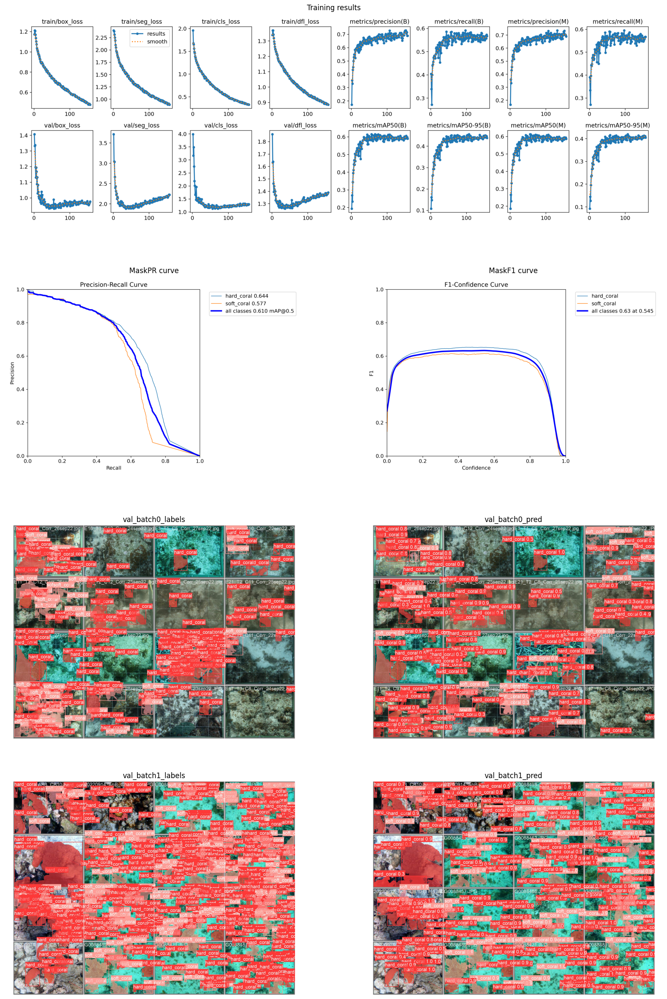

In [8]:
display_model_training_overview(MODEL_ROOT_DIR)

### Quantitative evaluation

In this section, we evaluate the model performance on the full validation set and report the different metrics and confusion matrix.
Note: the script is currenlty quite slow (especially on CPU) - 

Loading cache /home/chouffe/fruitpunch/challenges/coralreefs2/.cache/segment/model_number_14/177b1ad39d4ac3d4ac5032ca4367667d9a296130/annotations_and_prediction.pkl


Generating metrics...
Loading cache /home/chouffe/fruitpunch/challenges/coralreefs2/.cache/segment/model_number_14/177b1ad39d4ac3d4ac5032ca4367667d9a296130/evaluation_metrics.pkl
Loading cache /home/chouffe/fruitpunch/challenges/coralreefs2/.cache/segment/model_number_14/177b1ad39d4ac3d4ac5032ca4367667d9a296130/evaluate_model.pkl

Evaluation Metrics
------------------
Dice
    mean:       0.82
    soft coral: 0.72
    hard coral: 0.78
    other:      0.95
IoU
    mean:       0.74
    soft coral: 0.63
    hard coral: 0.67
    other:      0.91



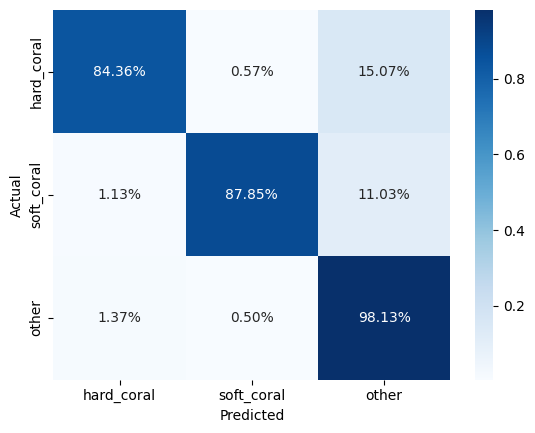

In [64]:
N = len(validation_image_filepaths)
batch_size = 5
r = evaluate_model(model, validation_image_filepaths[:N], batch_size=batch_size)

### Qualitative evaluation

In this section, we visualize the model predictions and look at the evaluation metrics at the datapoint level.
Some viz tool was created to better understand where the model makes mistakes as we identify missed segments and spurious predictions.


image 1/1 /home/chouffe/fruitpunch/challenges/coralreefs2/datasets/benthic_datasets/yolov8_ready/SEAFLOWER_BOLIVAR_and_SEAFLOWER_COURTOWN_and_SEAVIEW_ATL_and_SEAVIEW_IDN_PHL_and_SEAVIEW_PAC_AUS_and_TETES_PROVIDENCIA/val/images/20015178801.jpg: 1024x1024 4 hard_corals, 12 soft_corals, 3846.5ms
Speed: 13.2ms preprocess, 3846.5ms inference, 45.3ms postprocess per image at shape (1, 3, 1024, 1024)

Evaluation Metrics
------------------
Instances
    annotation
         soft coral: 14
         hard coral: 7
    prediction
         soft coral: 12
         hard coral: 4
Dice
    mean:       0.71
    soft coral: 0.87
    hard coral: 0.34
    other:      0.94
IoU
    mean:       0.62
    soft coral: 0.77
    hard coral: 0.20
    other:      0.88


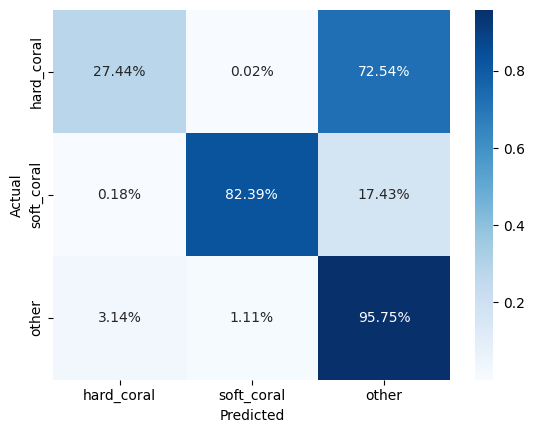

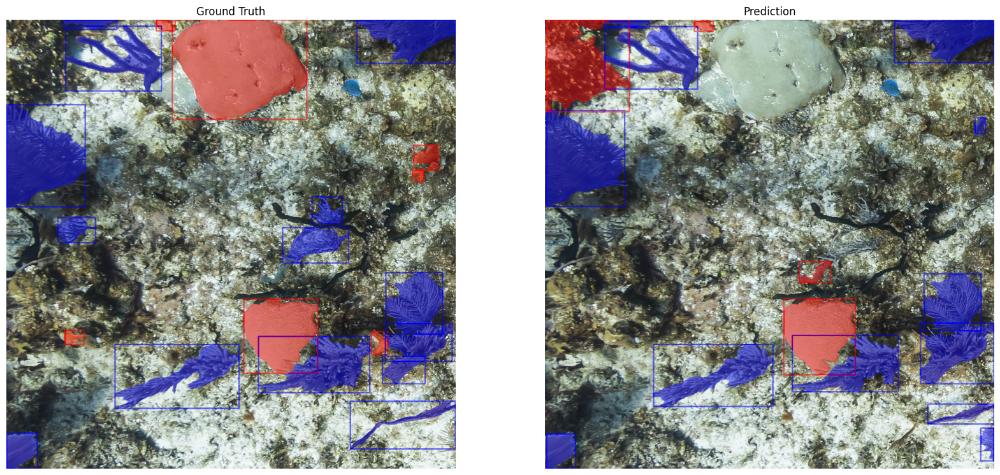

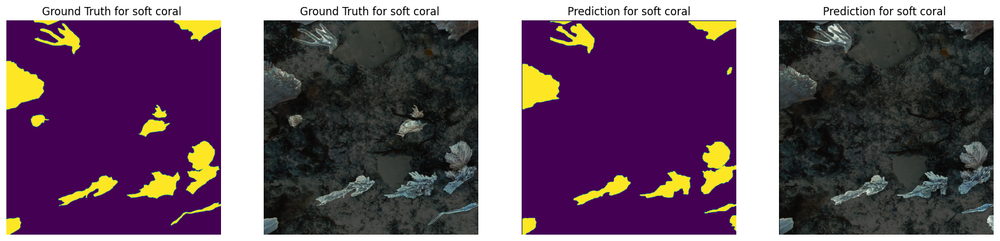

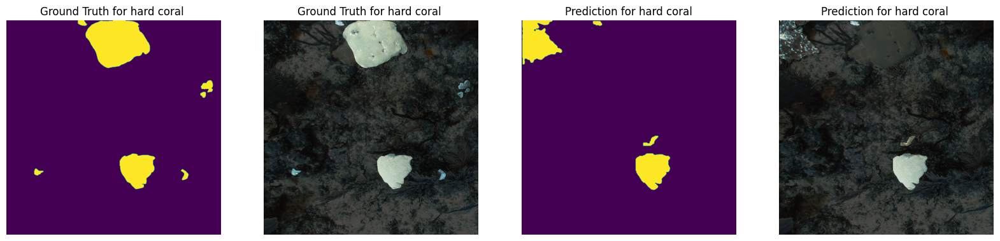

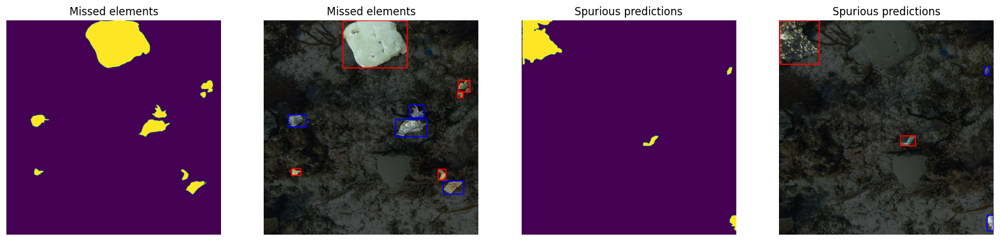

In [66]:
# Analyzing an image and model predictions
idx = 0
image_filepath = validation_image_filepaths[idx]
analyze_prediction_from(model, image_filepath)


image 1/1 /home/chouffe/fruitpunch/challenges/coralreefs2/datasets/benthic_datasets/yolov8_ready/SEAFLOWER_BOLIVAR_and_SEAFLOWER_COURTOWN_and_SEAVIEW_ATL_and_SEAVIEW_IDN_PHL_and_SEAVIEW_PAC_AUS_and_TETES_PROVIDENCIA/val/images/17039237202.jpg: 1024x1024 11 hard_corals, 1 soft_coral, 3860.9ms
Speed: 13.6ms preprocess, 3860.9ms inference, 33.9ms postprocess per image at shape (1, 3, 1024, 1024)

Evaluation Metrics
------------------
Instances
    annotation
         soft coral: 0
         hard coral: 0
    prediction
         soft coral: 1
         hard coral: 11
Dice
    mean:       0.28
    soft coral: 0.00
    hard coral: 0.00
    other:      0.84
IoU
    mean:       0.24
    soft coral: 0.00
    hard coral: 0.00
    other:      0.72


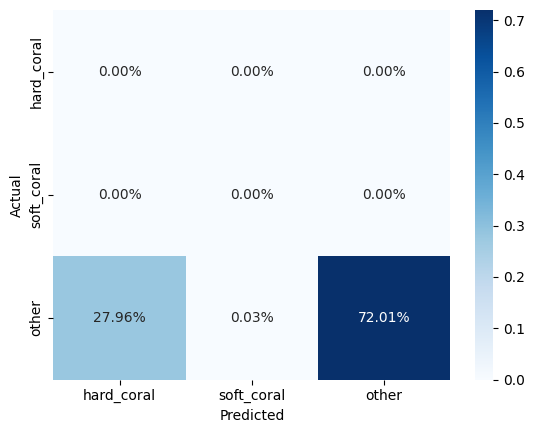

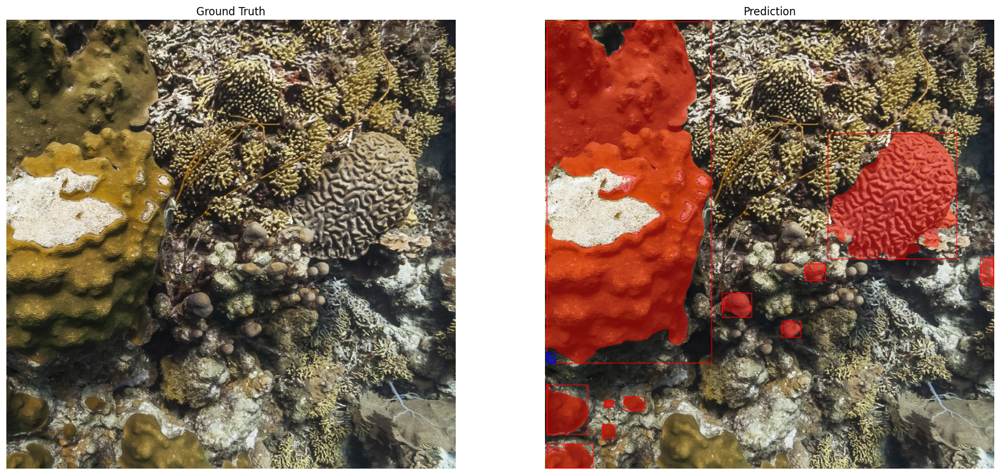

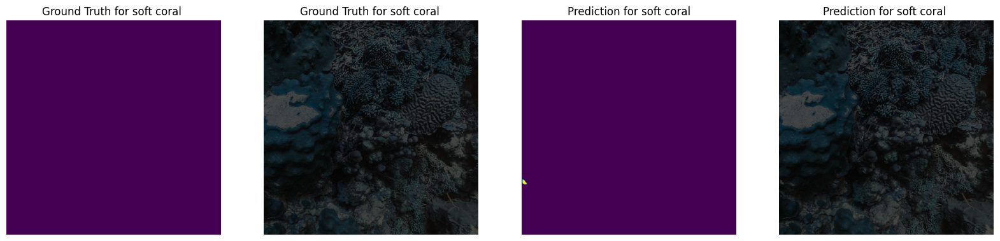

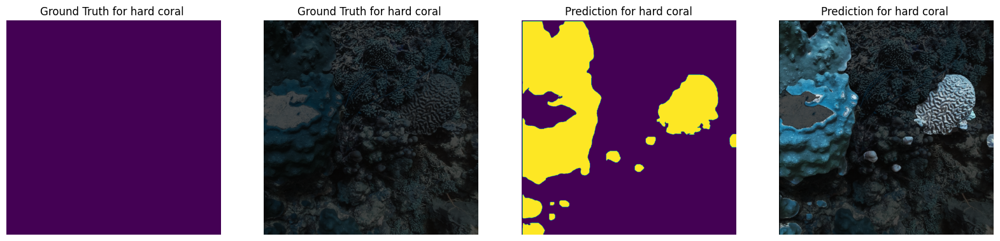

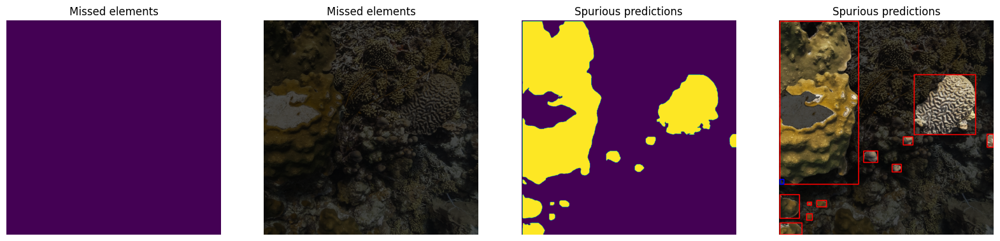

In [67]:
# Analyzing an image and model predictions
idx = 2
image_filepath = validation_image_filepaths[idx]
analyze_prediction_from(model, image_filepath)


image 1/1 /home/chouffe/fruitpunch/challenges/coralreefs2/datasets/benthic_datasets/yolov8_ready/SEAFLOWER_BOLIVAR_and_SEAFLOWER_COURTOWN_and_SEAVIEW_ATL_and_SEAVIEW_IDN_PHL_and_SEAVIEW_PAC_AUS_and_TETES_PROVIDENCIA/val/images/15026125602.jpg: 1024x1024 22 hard_corals, 3881.2ms
Speed: 8.8ms preprocess, 3881.2ms inference, 47.4ms postprocess per image at shape (1, 3, 1024, 1024)

Evaluation Metrics
------------------
Instances
    annotation
         soft coral: 0
         hard coral: 18
    prediction
         soft coral: 0
         hard coral: 22
Dice
    mean:       0.59
    soft coral: 0.00
    hard coral: 0.94
    other:      0.82
IoU
    mean:       0.53
    soft coral: 0.00
    hard coral: 0.88
    other:      0.70


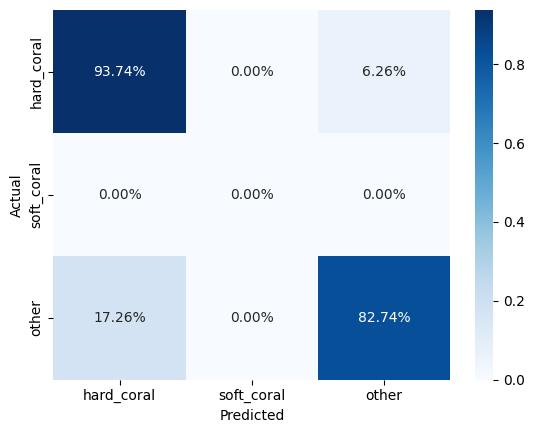

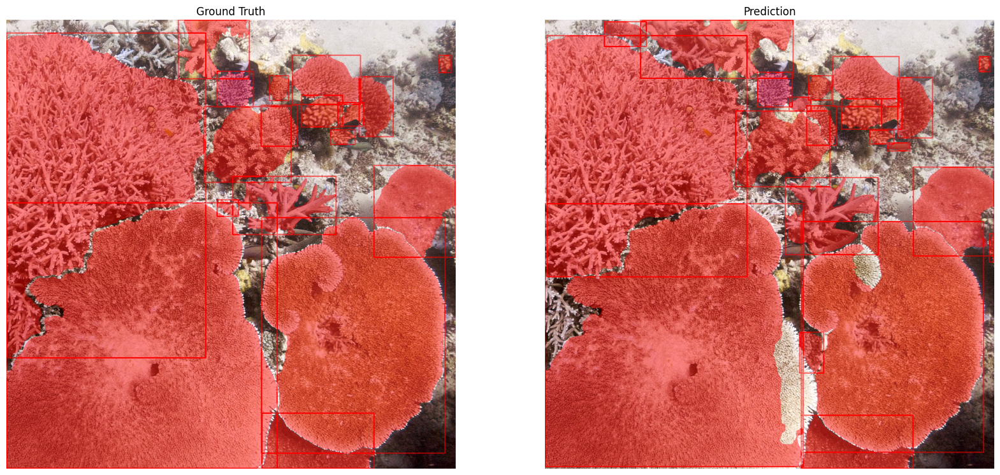

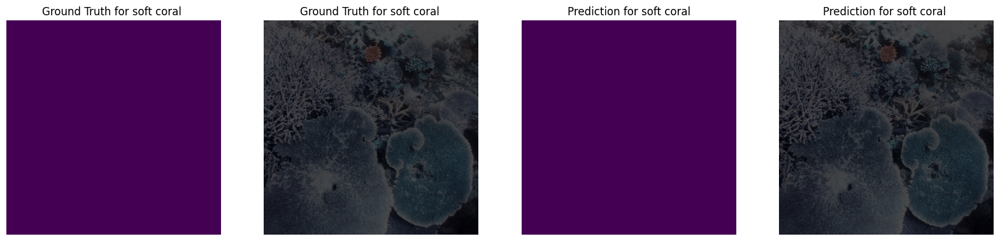

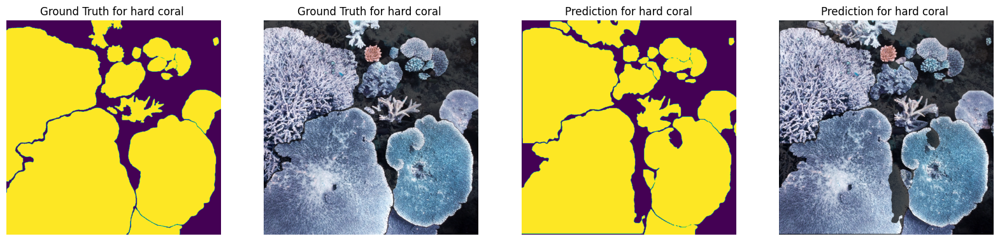

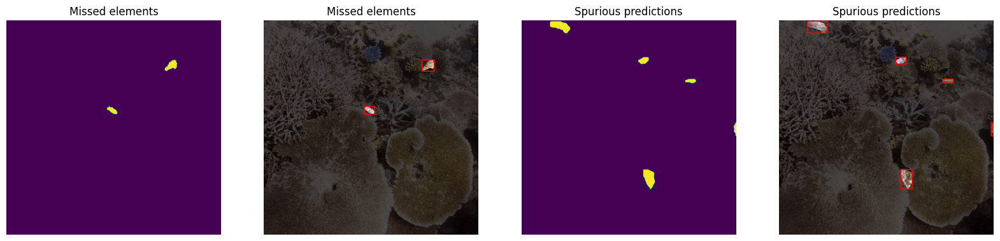

In [68]:
# Analyzing an image and model predictions
idx = 13
image_filepath = validation_image_filepaths[idx]
analyze_prediction_from(model, image_filepath)


image 1/1 /home/chouffe/fruitpunch/challenges/coralreefs2/datasets/benthic_datasets/yolov8_ready/SEAFLOWER_BOLIVAR_and_SEAFLOWER_COURTOWN_and_SEAVIEW_ATL_and_SEAVIEW_IDN_PHL_and_SEAVIEW_PAC_AUS_and_TETES_PROVIDENCIA/val/images/E7_T2_C7_Corr_29sep22.jpg: 800x1024 6 hard_corals, 2937.0ms
Speed: 6.3ms preprocess, 2937.0ms inference, 10.7ms postprocess per image at shape (1, 3, 800, 1024)

Evaluation Metrics
------------------
Instances
    annotation
         soft coral: 0
         hard coral: 6
    prediction
         soft coral: 0
         hard coral: 6
Dice
    mean:       0.64
    soft coral: 0.00
    hard coral: 0.94
    other:      0.98
IoU
    mean:       0.62
    soft coral: 0.00
    hard coral: 0.88
    other:      0.97


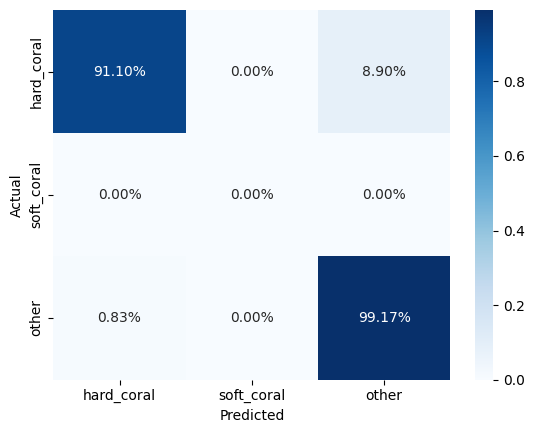

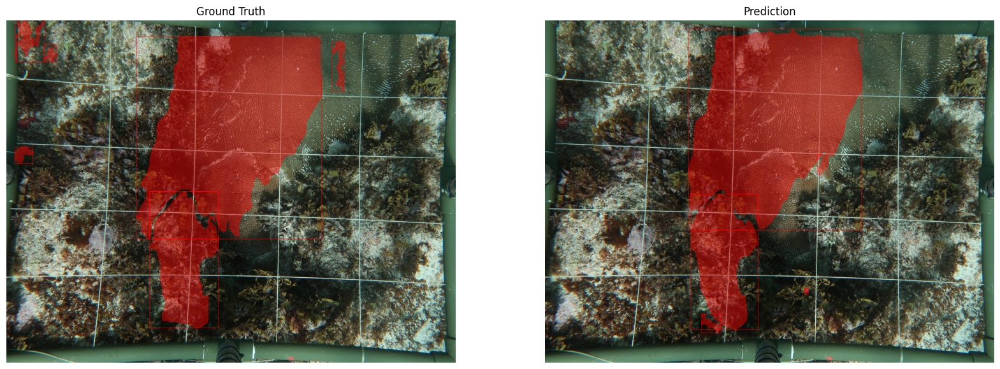

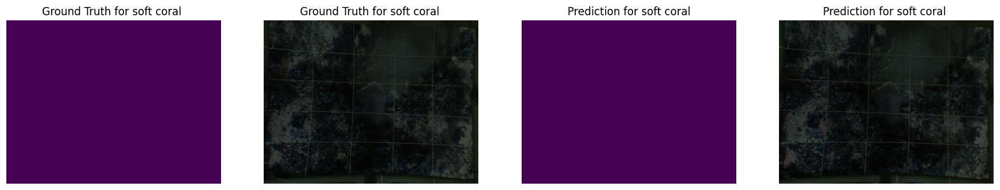

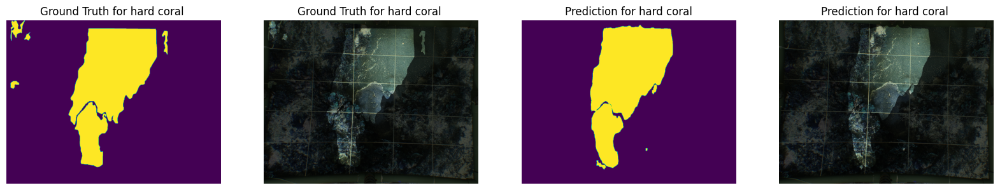

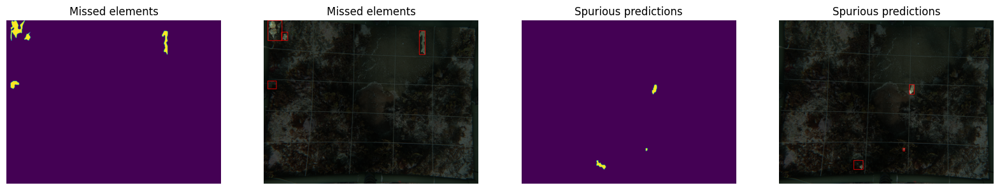

In [69]:
# Analyzing an image and model predictions
idx = 25
image_filepath = validation_image_filepaths[idx]
analyze_prediction_from(model, image_filepath)


image 1/1 /home/chouffe/fruitpunch/challenges/coralreefs2/datasets/benthic_datasets/yolov8_ready/SEAFLOWER_BOLIVAR_and_SEAFLOWER_COURTOWN_and_SEAVIEW_ATL_and_SEAVIEW_IDN_PHL_and_SEAVIEW_PAC_AUS_and_TETES_PROVIDENCIA/val/images/33006257801.jpg: 1024x1024 13 hard_corals, 3763.5ms
Speed: 7.4ms preprocess, 3763.5ms inference, 37.1ms postprocess per image at shape (1, 3, 1024, 1024)

Evaluation Metrics
------------------
Instances
    annotation
         soft coral: 0
         hard coral: 15
    prediction
         soft coral: 0
         hard coral: 13
Dice
    mean:       0.57
    soft coral: 0.00
    hard coral: 0.86
    other:      0.85
IoU
    mean:       0.5
    soft coral: 0.00
    hard coral: 0.76
    other:      0.74


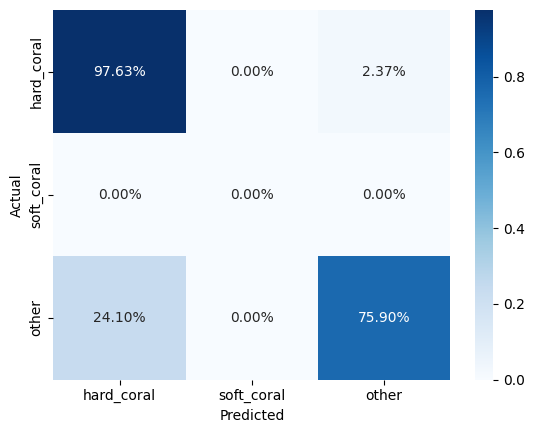

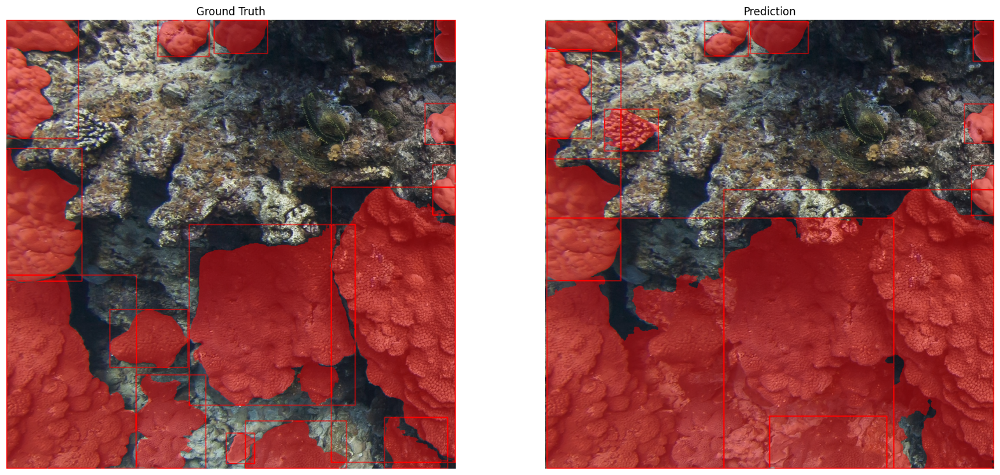

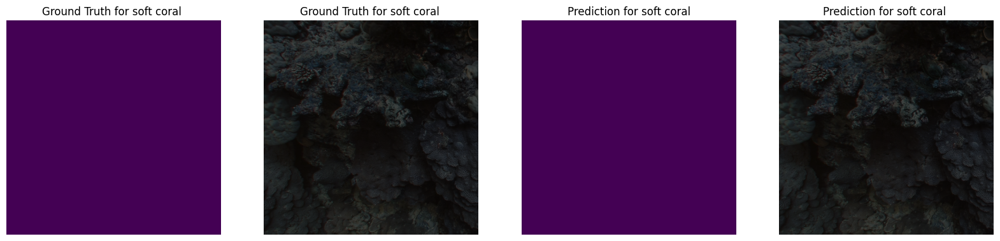

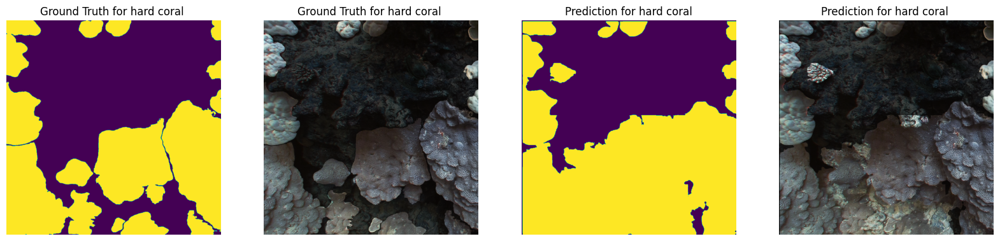

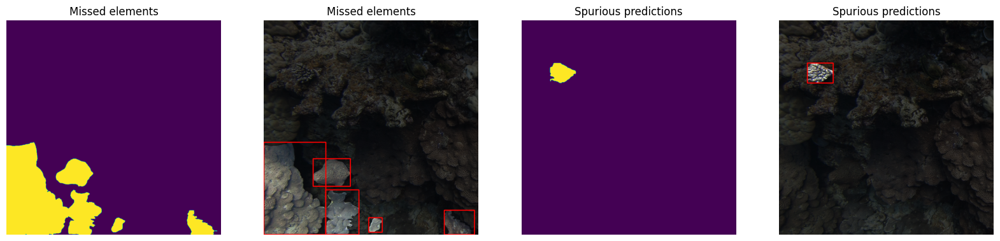

In [70]:
# Analyzing an image and model predictions
idx = 61
image_filepath = validation_image_filepaths[idx]
analyze_prediction_from(model, image_filepath)


image 1/1 /home/chouffe/fruitpunch/challenges/coralreefs2/datasets/benthic_datasets/yolov8_ready/SEAFLOWER_BOLIVAR_and_SEAFLOWER_COURTOWN_and_SEAVIEW_ATL_and_SEAVIEW_IDN_PHL_and_SEAVIEW_PAC_AUS_and_TETES_PROVIDENCIA/val/images/10005046502.jpg: 1024x1024 13 hard_corals, 3750.2ms
Speed: 10.8ms preprocess, 3750.2ms inference, 38.3ms postprocess per image at shape (1, 3, 1024, 1024)

Evaluation Metrics
------------------
Instances
    annotation
         soft coral: 0
         hard coral: 11
    prediction
         soft coral: 0
         hard coral: 13
Dice
    mean:       0.63
    soft coral: 0.00
    hard coral: 0.89
    other:      0.99
IoU
    mean:       0.6
    soft coral: 0.00
    hard coral: 0.80
    other:      0.99


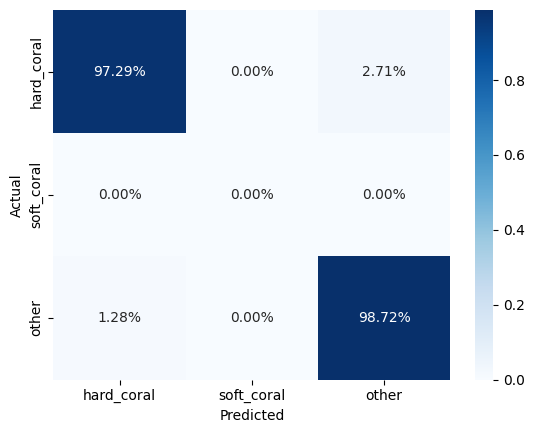

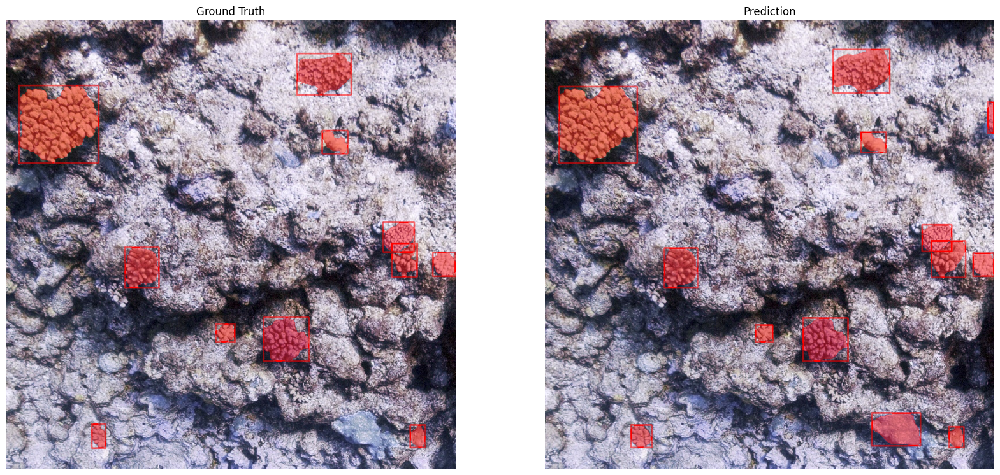

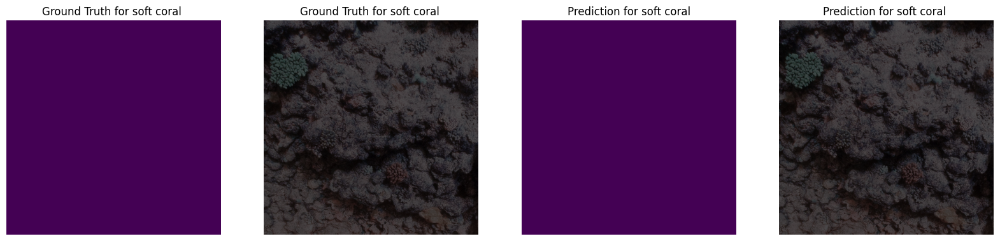

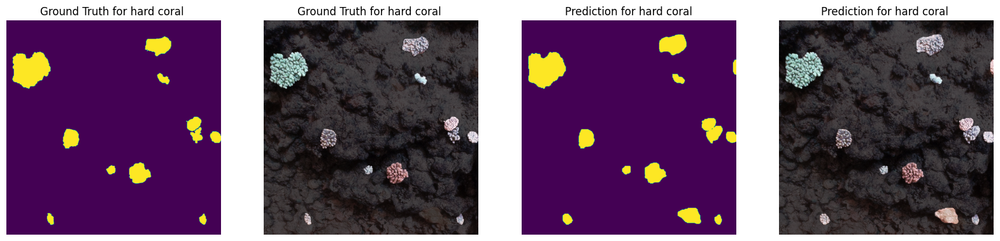

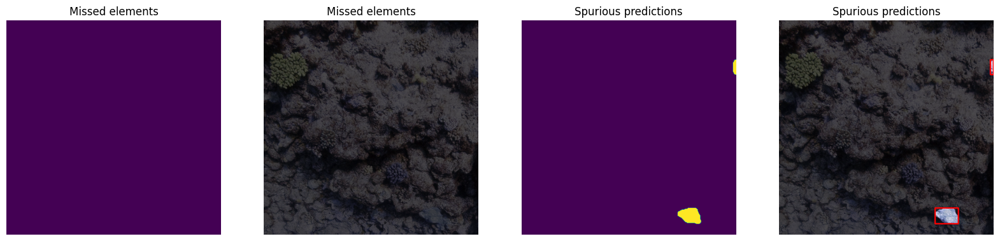

In [71]:
# Analyzing an image and model predictions
idx = 42
image_filepath = validation_image_filepaths[idx]
analyze_prediction_from(model, image_filepath)


image 1/1 /home/chouffe/fruitpunch/challenges/coralreefs2/datasets/benthic_datasets/yolov8_ready/SEAFLOWER_BOLIVAR_and_SEAFLOWER_COURTOWN_and_SEAVIEW_ATL_and_SEAVIEW_IDN_PHL_and_SEAVIEW_PAC_AUS_and_TETES_PROVIDENCIA/val/images/25016137801.jpg: 1024x1024 2 hard_corals, 16 soft_corals, 4062.2ms
Speed: 10.6ms preprocess, 4062.2ms inference, 48.6ms postprocess per image at shape (1, 3, 1024, 1024)

Evaluation Metrics
------------------
Instances
    annotation
         soft coral: 10
         hard coral: 1
    prediction
         soft coral: 16
         hard coral: 2
Dice
    mean:       0.95
    soft coral: 0.92
    hard coral: 0.95
    other:      0.99
IoU
    mean:       0.91
    soft coral: 0.85
    hard coral: 0.90
    other:      0.98


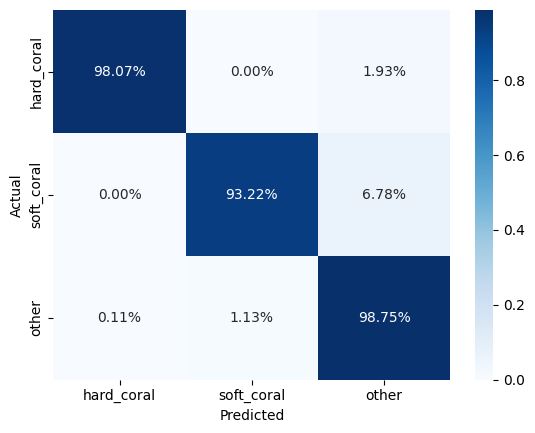

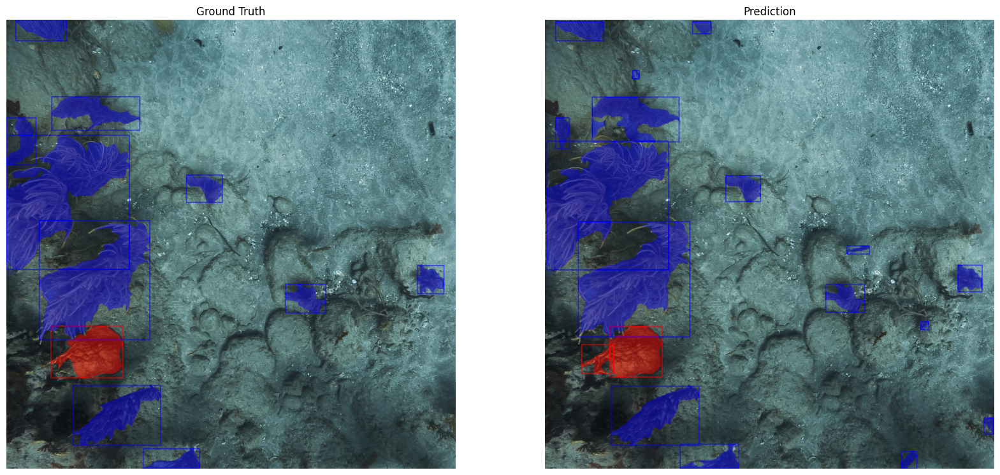

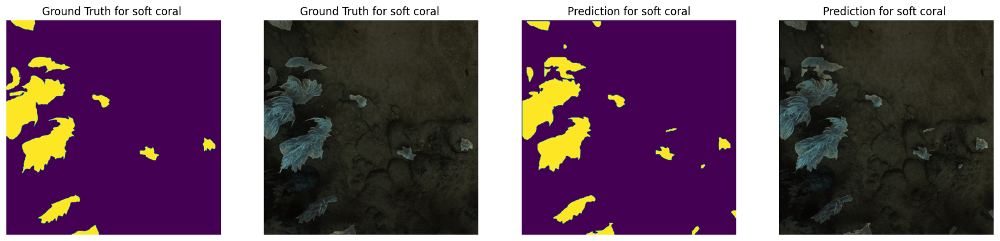

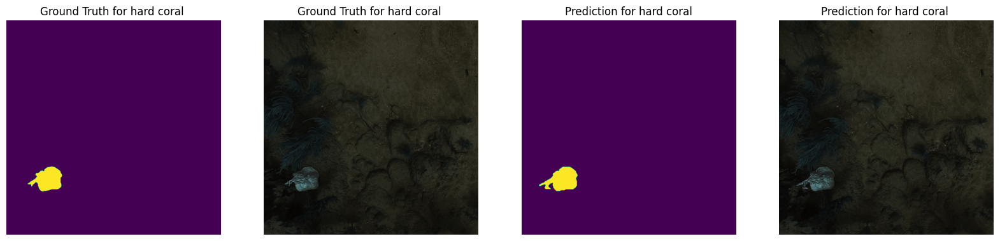

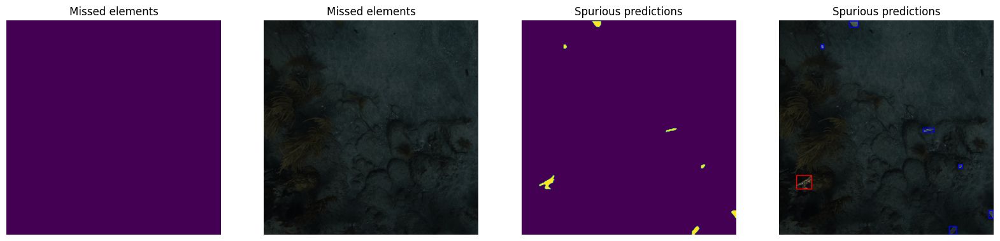

In [72]:
# Analyzing an image and model predictions
idx = 43
image_filepath = validation_image_filepaths[idx]
analyze_prediction_from(model, image_filepath)